In [1]:
from glob import glob
import face_recognition
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import math

%matplotlib inline
plt.rcParams.update({'figure.max_open_warning': 0})  # ignore warning

In [2]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def show_image(list_, size=50, ispath=False):
    if ispath:
        list_ = [mpimg.imread(file) for file in list_]
    
    figure_size = math.ceil(math.sqrt(len(list_)))
    fig = plt.figure(figsize=(size, size))
    for i, image in enumerate(list_):
        a = fig.add_subplot(figure_size, figure_size, i + 1)
        imgplot = plt.imshow(image)

In [3]:
files = glob('face_data/*')

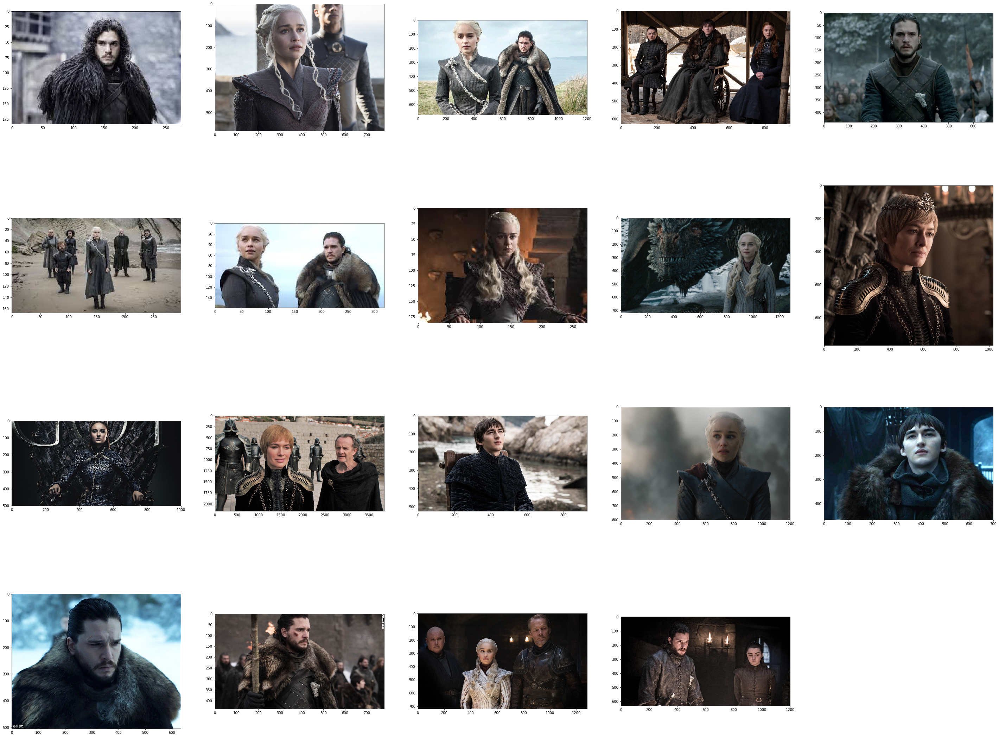

In [4]:
show_image(files, ispath=True)

In [5]:
FACE = {
    'face_location': [],
    'filepath': [],
    'face_image': [],
    'encoding': [],
}

for file in files:
    # Load the jpg file into a numpy array
    image = face_recognition.load_image_file(file)
    face_locations = face_recognition.face_locations(image)
    
    count_image_have_feature = 0
    for face_location in face_locations:
        # Print the location of each face in this image
        top, right, bottom, left = face_location
        # print("A face is located at pixel location Top: {}, Left: {}, Bottom: {}, Right: {}".format(top, left, bottom, right))

        # You can access the actual face itself like this:
        face_image = image[top:bottom, left:right]
        
        encoding = face_recognition.face_encodings(face_image)
        if encoding != []:
            FACE['face_location'].append(face_location)
            FACE['filepath'].append(file)
            FACE['face_image'].append(face_image) 
            FACE['encoding'].append(encoding[0])
            
            count_image_have_feature += 1
            
    print(file)
    print("I found {} face(s) in this photograph.".format(len(face_locations)))
    print('Image have feature: ', count_image_have_feature, end='\n\n')

face_data\image (1).jpg
I found 1 face(s) in this photograph.
Image have feature:  1

face_data\image (10).jpg
I found 1 face(s) in this photograph.
Image have feature:  1

face_data\image (11).jpg
I found 2 face(s) in this photograph.
Image have feature:  2

face_data\image (12).jpg
I found 3 face(s) in this photograph.
Image have feature:  3

face_data\image (13).jpg
I found 2 face(s) in this photograph.
Image have feature:  1

face_data\image (14).jpg
I found 0 face(s) in this photograph.
Image have feature:  0

face_data\image (15).jpg
I found 2 face(s) in this photograph.
Image have feature:  2

face_data\image (16).jpg
I found 1 face(s) in this photograph.
Image have feature:  1

face_data\image (17).jpg
I found 1 face(s) in this photograph.
Image have feature:  1

face_data\image (18).jpg
I found 0 face(s) in this photograph.
Image have feature:  0

face_data\image (19).jpg
I found 1 face(s) in this photograph.
Image have feature:  1

face_data\image (2).jpg
I found 2 face(s) in

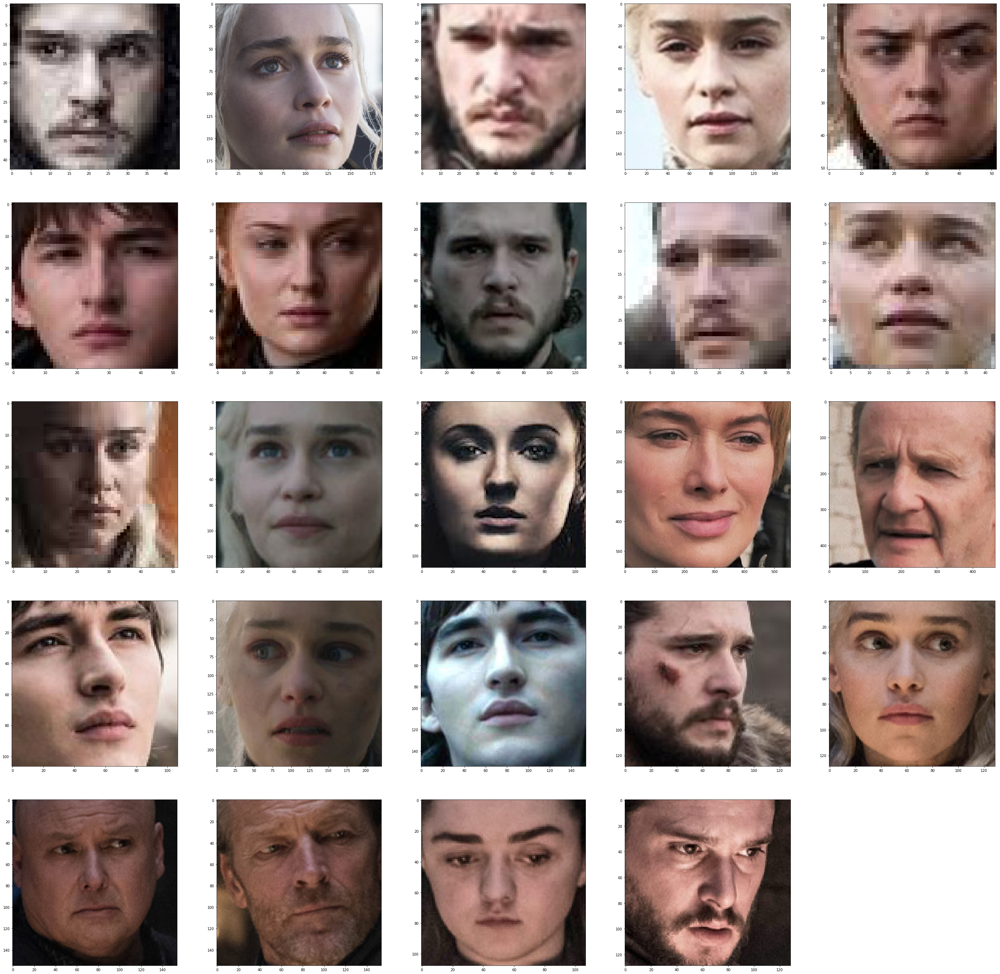

In [6]:
show_image(FACE['face_image'])

## Clustering

In [7]:
face_encoding = FACE['encoding']

r = list(range(len(face_encoding)))
face_cluster = []
while len(r) > 0:
    face_cluster.append([])
    result = face_recognition.compare_faces(face_encoding, face_encoding[r[0]], tolerance=0.6)
    for index, boo in enumerate(result):
        if boo and index in r:
            face_cluster[-1].append(index)
            r.remove(index)

In [8]:
print(face_cluster)
print('number of cluster: ', len(face_cluster))

[[0, 2, 7, 8, 18, 23], [1, 3, 9, 10, 11, 16, 19], [4, 22], [5, 15, 17], [6, 12], [13], [14], [20], [21]]
number of cluster:  9


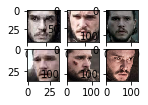

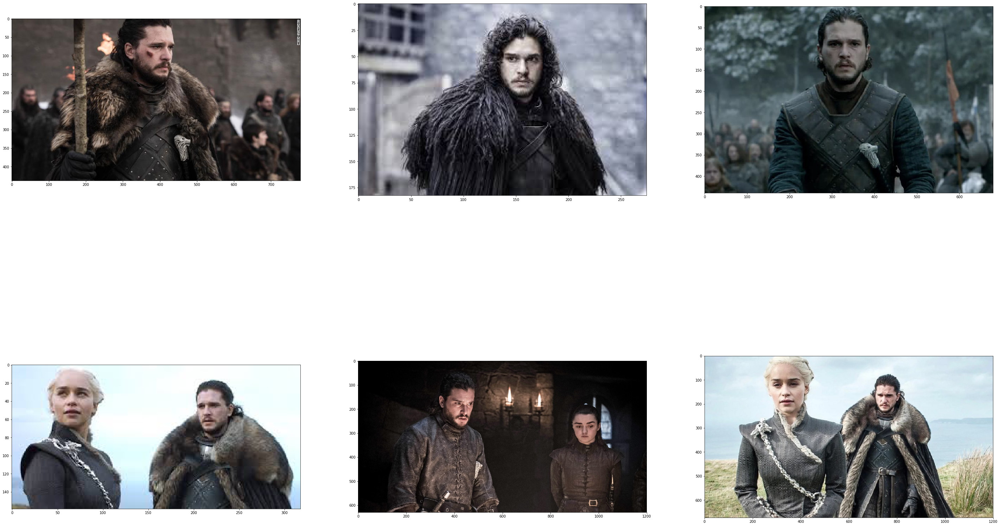

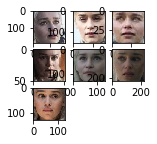

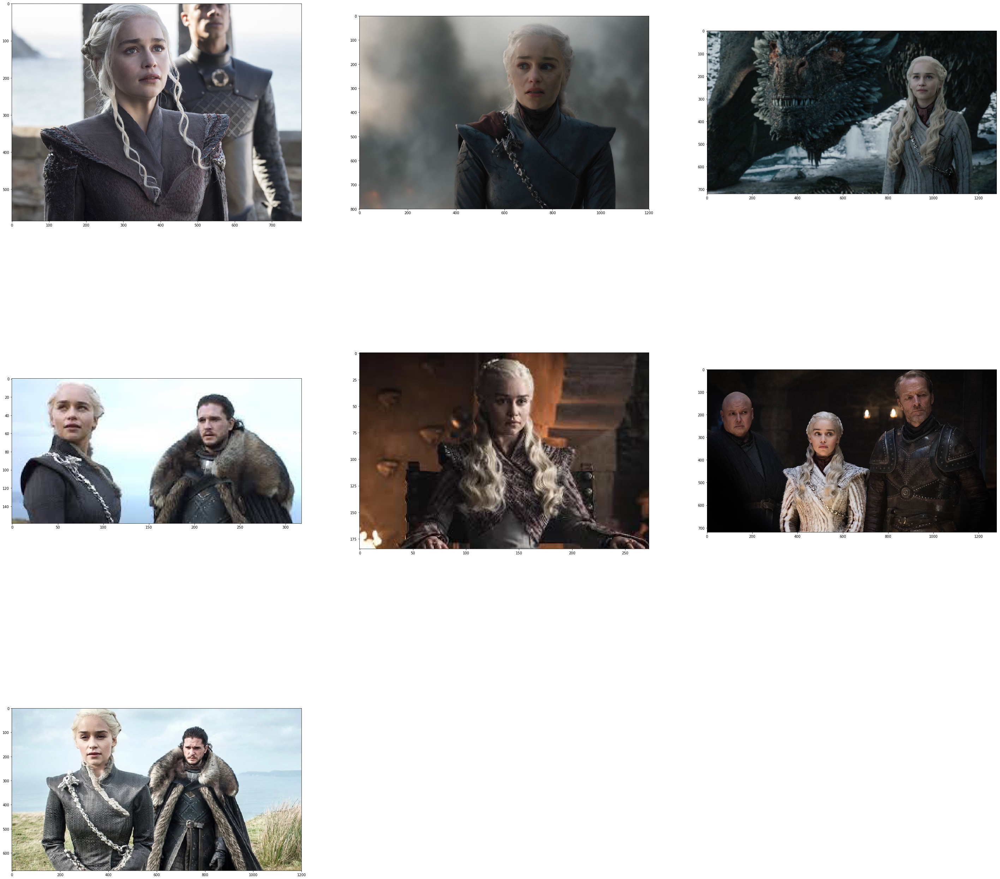

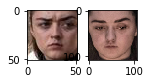

...

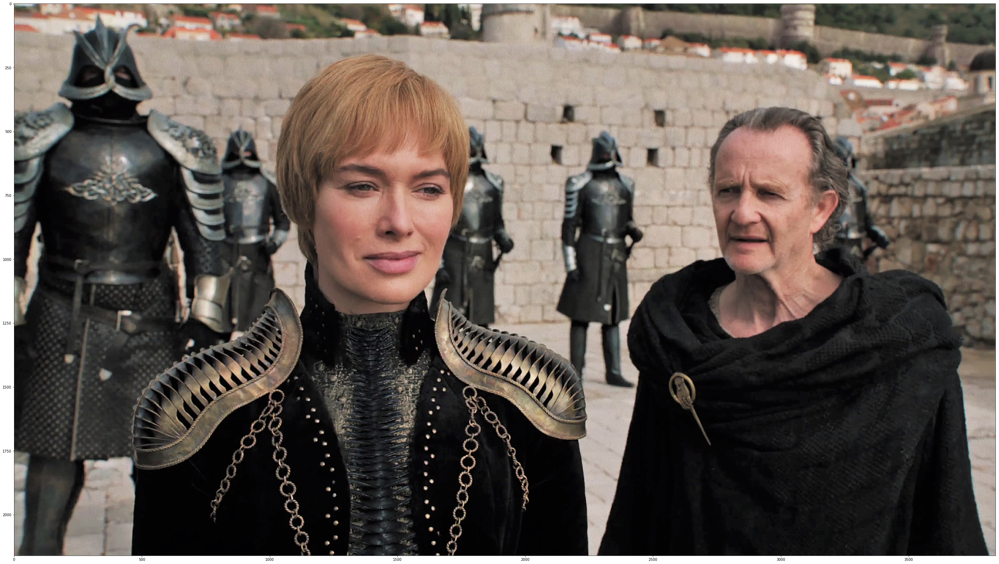

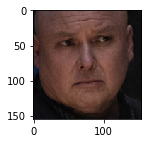

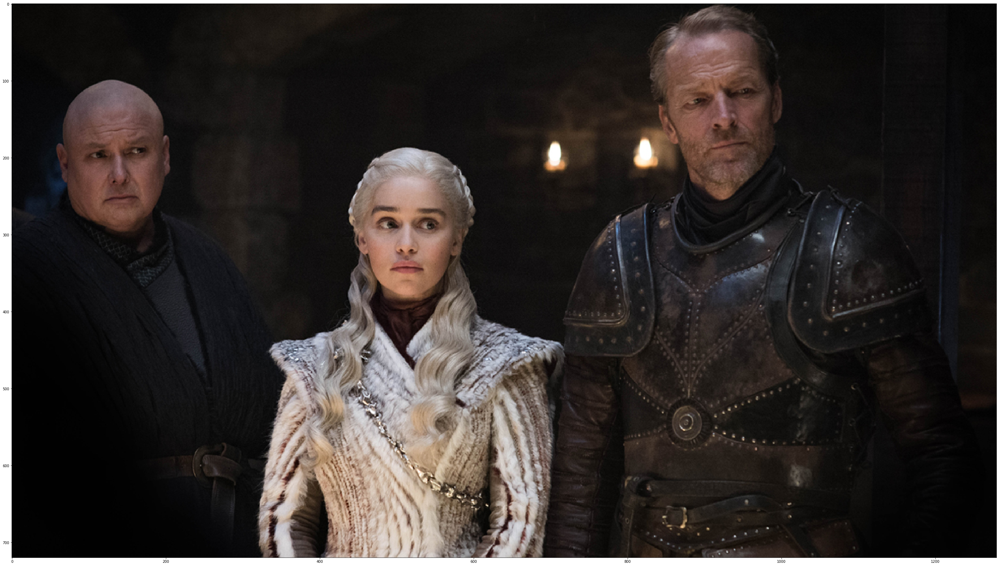

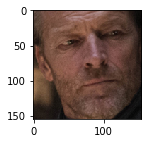

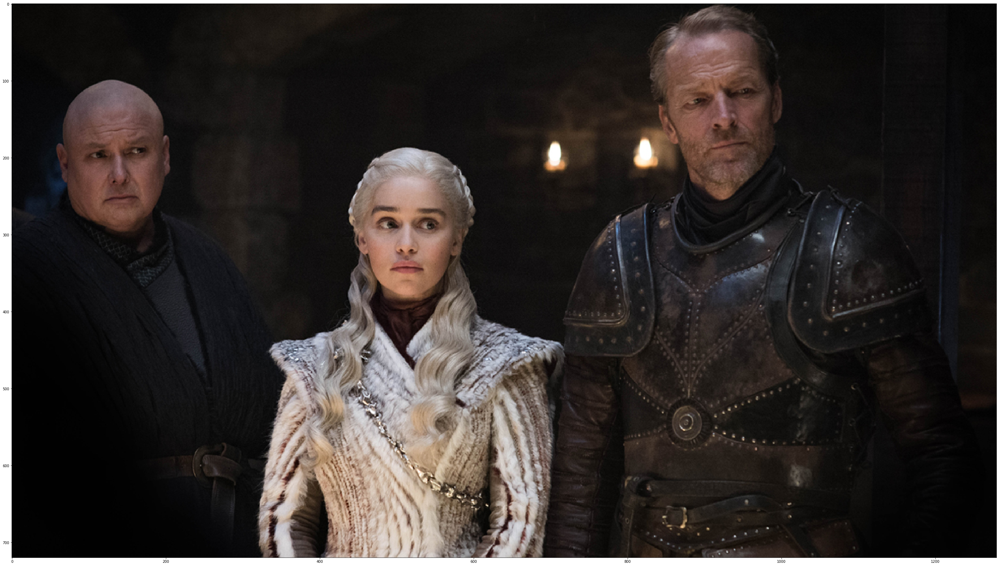

In [9]:
for cluster in face_cluster:
    faces = [FACE['face_image'][index]  for index in cluster]
    image_path = [FACE['filepath'][index] for index in cluster]
    image_path = list(set(image_path))
    
    show_image(faces, size=2)
    show_image(image_path, ispath=True)